In [75]:
#importing libraries
import numpy as np
import pandas as pd
import seaborn as sns

import matplotlib
import matplotlib.pyplot as plt
plt.style.use("ggplot")
from matplotlib.pyplot import figure


In [76]:
df=pd.read_csv(r"C:\Users\Samhith\Documents\movies.csv.zip")

In [3]:
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,46998772.0,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,58853106.0,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,538375067.0,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,83453539.0,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,39846344.0,Orion Pictures,98.0


In [4]:
df.tail()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
7663,More to Life,NaN,Drama,2020,"October 23, 2020 (United States)",3.1,18.0,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000.0,NaN,NaN,90.0
7664,Dream Round,NaN,Comedy,2020,"February 7, 2020 (United States)",4.7,36.0,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,NaN,NaN,Cactus Blue Entertainment,90.0
7665,Saving Mbango,NaN,Drama,2020,"April 27, 2020 (Cameroon)",5.7,29.0,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750.0,NaN,Embi Productions,NaN
7666,It's Just Us,NaN,Drama,2020,"October 1, 2020 (United States)",NaN,NaN,James Randall,James Randall,Christina Roz,United States,15000.0,NaN,NaN,120.0
7667,Tee em el,NaN,Horror,2020,"August 19, 2020 (United States)",5.7,7.0,Pereko Mosia,Pereko Mosia,Siyabonga Mabaso,South Africa,NaN,NaN,PK 65 Films,102.0


## DATA CLEANING

In [5]:
df.columns

Index(['name', 'rating', 'genre', 'year', 'released', 'score', 'votes',
       'director', 'writer', 'star', 'country', 'budget', 'gross', 'company',
       'runtime'],
      dtype='object')

In [6]:
missing_data=df.isnull()
for column in missing_data.columns.values.tolist():
    print(column)
    print (missing_data[column].value_counts())
    print("")

name
False    7668
Name: name, dtype: int64

rating
False    7591
True       77
Name: rating, dtype: int64

genre
False    7668
Name: genre, dtype: int64

year
False    7668
Name: year, dtype: int64

released
False    7666
True        2
Name: released, dtype: int64

score
False    7665
True        3
Name: score, dtype: int64

votes
False    7665
True        3
Name: votes, dtype: int64

director
False    7668
Name: director, dtype: int64

writer
False    7665
True        3
Name: writer, dtype: int64

star
False    7667
True        1
Name: star, dtype: int64

country
False    7665
True        3
Name: country, dtype: int64

budget
False    5497
True     2171
Name: budget, dtype: int64

gross
False    7479
True      189
Name: gross, dtype: int64

company
False    7651
True       17
Name: company, dtype: int64

runtime
False    7664
True        4
Name: runtime, dtype: int64



In [7]:
df["rating"].value_counts()


R            3697
PG-13        2112
PG           1252
Not Rated     283
G             153
Unrated        52
NC-17          23
TV-MA           9
TV-PG           5
X               3
Approved        1
TV-14           1
Name: rating, dtype: int64

In [8]:
df["rating"].replace(np.NaN,'R',inplace=True)
df["rating"].isnull()

0       False
1       False
2       False
3       False
4       False
        ...  
7663    False
7664    False
7665    False
7666    False
7667    False
Name: rating, Length: 7668, dtype: bool

In [9]:
df["released"].dropna(inplace=True)

In [10]:
df["released"].info()

<class 'pandas.core.series.Series'>
RangeIndex: 7668 entries, 0 to 7667
Series name: released
Non-Null Count  Dtype 
--------------  ----- 
7666 non-null   object
dtypes: object(1)
memory usage: 60.0+ KB


In [11]:
df["budget"].value_counts()

20000000.0    233
30000000.0    229
25000000.0    211
10000000.0    208
15000000.0    204
             ... 
34200000.0      1
30000.0         1
29750000.0      1
5250000.0       1
58750.0         1
Name: budget, Length: 413, dtype: int64

In [12]:
df["budget"].mean()

35589876.192650534

In [13]:
df["budget"].replace(np.NaN,df["budget"].mean(),inplace=True)
df["budget"].info()

<class 'pandas.core.series.Series'>
RangeIndex: 7668 entries, 0 to 7667
Series name: budget
Non-Null Count  Dtype  
--------------  -----  
7668 non-null   float64
dtypes: float64(1)
memory usage: 60.0 KB


In [14]:
df["gross"].mean()

78500541.01778312

In [15]:
df["gross"].replace(np.NaN,df["gross"].mean(),inplace=True)
df["gross"].info()

<class 'pandas.core.series.Series'>
RangeIndex: 7668 entries, 0 to 7667
Series name: gross
Non-Null Count  Dtype  
--------------  -----  
7668 non-null   float64
dtypes: float64(1)
memory usage: 60.0 KB


In [16]:
df[["runtime","writer","star"]].dropna(inplace=True)
df[["runtime","writer","star"]].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7668 entries, 0 to 7667
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   runtime  7664 non-null   float64
 1   writer   7665 non-null   object 
 2   star     7667 non-null   object 
dtypes: float64(1), object(2)
memory usage: 179.8+ KB


C:\Users\Samhith\AppData\Local\Temp\ipykernel_15684\305858972.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[["runtime","writer","star"]].dropna(inplace=True)


In [17]:
df["country"].value_counts()

United States                     5475
United Kingdom                     816
France                             279
Canada                             190
Germany                            117
Australia                           92
Japan                               81
India                               62
Italy                               61
Spain                               47
Hong Kong                           45
Ireland                             43
China                               40
South Korea                         35
Denmark                             32
Sweden                              25
New Zealand                         25
Mexico                              22
Norway                              12
West Germany                        12
Netherlands                         12
Iran                                10
Switzerland                         10
Russia                               8
Belgium                              8
Argentina                

In [18]:
df["company"].value_counts()

Universal Pictures          377
Warner Bros.                334
Columbia Pictures           332
Paramount Pictures          320
Twentieth Century Fox       240
                           ... 
Digital Image Associates      1
Kopelson Entertainment        1
Clavius Base                  1
Tim Burton Productions        1
PK 65 Films                   1
Name: company, Length: 2385, dtype: int64

In [19]:
df[["score","country","company"]].mode()

,score,country,company
0,6.6,United States,Universal Pictures


In [20]:
df["score"].replace(np.NaN,6.6,inplace=True)
df["score"].info()

<class 'pandas.core.series.Series'>
RangeIndex: 7668 entries, 0 to 7667
Series name: score
Non-Null Count  Dtype  
--------------  -----  
7668 non-null   float64
dtypes: float64(1)
memory usage: 60.0 KB


In [21]:
df["country"].replace(np.NaN,"United States",inplace=True)
df["country"].info()

<class 'pandas.core.series.Series'>
RangeIndex: 7668 entries, 0 to 7667
Series name: country
Non-Null Count  Dtype 
--------------  ----- 
7668 non-null   object
dtypes: object(1)
memory usage: 60.0+ KB


In [22]:
df["company"].replace(np.NaN,"Universal Pictures",inplace=True)
df["company"].info()

<class 'pandas.core.series.Series'>
RangeIndex: 7668 entries, 0 to 7667
Series name: company
Non-Null Count  Dtype 
--------------  ----- 
7668 non-null   object
dtypes: object(1)
memory usage: 60.0+ KB


In [23]:
df.dtypes

name         object
rating       object
genre        object
year          int64
released     object
score       float64
votes       float64
director     object
writer       object
star         object
country      object
budget      float64
gross       float64
company      object
runtime     float64
dtype: object

In [24]:
#changing datatype of budget and gross

In [25]:
df["budget"]=df["budget"].astype("int64")
df["gross"]=df["gross"].astype("int64")

In [26]:
df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,R,Drama,2020,"October 23, 2020 (United States)",3.1,18.0,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000,78500541,Universal Pictures,90.0
7664,Dream Round,R,Comedy,2020,"February 7, 2020 (United States)",4.7,36.0,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,35589876,78500541,Cactus Blue Entertainment,90.0
7665,Saving Mbango,R,Drama,2020,"April 27, 2020 (Cameroon)",5.7,29.0,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750,78500541,Embi Productions,NaN
7666,It's Just Us,R,Drama,2020,"October 1, 2020 (United States)",6.6,NaN,James Randall,James Randall,Christina Roz,United States,15000,78500541,Universal Pictures,120.0


In [27]:
#ordering the dataframe by gross revenue

In [78]:
df.sort_values(by=["gross"],inplace=False,ascending=False)

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
5445,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",7.8,1100000.0,James Cameron,James Cameron,Sam Worthington,United States,237000000.0,2.847246e+09,Twentieth Century Fox,162.0
7445,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.4,903000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000.0,2.797501e+09,Marvel Studios,181.0
3045,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",7.8,1100000.0,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000.0,2.201647e+09,Twentieth Century Fox,194.0
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",7.8,876000.0,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000.0,2.069522e+09,Lucasfilm,138.0
7244,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.4,897000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000.0,2.048360e+09,Marvel Studios,149.0
7480,The Lion King,PG,Animation,2019,"July 19, 2019 (United States)",6.9,222000.0,Jon Favreau,Jeff Nathanson,Donald Glover,United States,260000000.0,1.670728e+09,Walt Disney Pictures,118.0
6653,Jurassic World,PG-13,Action,2015,"June 12, 2015 (United States)",7.0,593000.0,Colin Trevorrow,Rick Jaffa,Chris Pratt,United States,150000000.0,1.670516e+09,Universal Pictures,124.0
6043,The Avengers,PG-13,Action,2012,"May 4, 2012 (United States)",8.0,1300000.0,Joss Whedon,Joss Whedon,Robert Downey Jr.,United States,220000000.0,1.518816e+09,Marvel Studios,143.0
6646,Furious 7,PG-13,Action,2015,"April 3, 2015 (United States)",7.1,370000.0,James Wan,Chris Morgan,Vin Diesel,United States,190000000.0,1.515341e+09,Universal Pictures,137.0
7494,Frozen II,PG,Animation,2019,"November 22, 2019 (United States)",6.8,148000.0,Chris Buck,Jennifer Lee,Kristen Bell,United States,150000000.0,1.450027e+09,Walt Disney Animation Studios,103.0


In [29]:
#to display all the rows

In [30]:
pd.set_option("display.max_rows",None)

In [31]:
df.sort_values(by=["gross"],inplace=False,ascending=False)

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
5445,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",7.8,1100000.0,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,Twentieth Century Fox,162.0
7445,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.4,903000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,Marvel Studios,181.0
3045,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",7.8,1100000.0,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,Twentieth Century Fox,194.0
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",7.8,876000.0,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,Lucasfilm,138.0
7244,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.4,897000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,Marvel Studios,149.0
7480,The Lion King,PG,Animation,2019,"July 19, 2019 (United States)",6.9,222000.0,Jon Favreau,Jeff Nathanson,Donald Glover,United States,260000000,1670727580,Walt Disney Pictures,118.0
6653,Jurassic World,PG-13,Action,2015,"June 12, 2015 (United States)",7.0,593000.0,Colin Trevorrow,Rick Jaffa,Chris Pratt,United States,150000000,1670516444,Universal Pictures,124.0
6043,The Avengers,PG-13,Action,2012,"May 4, 2012 (United States)",8.0,1300000.0,Joss Whedon,Joss Whedon,Robert Downey Jr.,United States,220000000,1518815515,Marvel Studios,143.0
6646,Furious 7,PG-13,Action,2015,"April 3, 2015 (United States)",7.1,370000.0,James Wan,Chris Morgan,Vin Diesel,United States,190000000,1515341399,Universal Pictures,137.0
7494,Frozen II,PG,Animation,2019,"November 22, 2019 (United States)",6.8,148000.0,Chris Buck,Jennifer Lee,Kristen Bell,United States,150000000,1450026933,Walt Disney Animation Studios,103.0


In [32]:
#drop any duplicates
#df=df["name"].drop_duplicates()

df["name"].drop_duplicates()

0                                             The Shining
1                                         The Blue Lagoon
2          Star Wars: Episode V - The Empire Strikes Back
3                                               Airplane!
4                                              Caddyshack
5                                         Friday the 13th
6                                      The Blues Brothers
7                                             Raging Bull
8                                             Superman II
9                                         The Long Riders
10                                  Any Which Way You Can
11                                 The Gods Must Be Crazy
12                                                 Popeye
13                                        Ordinary People
14                                        Dressed to Kill
15                                      Somewhere in Time
16                                                   Fame
17            

## CORRELATION


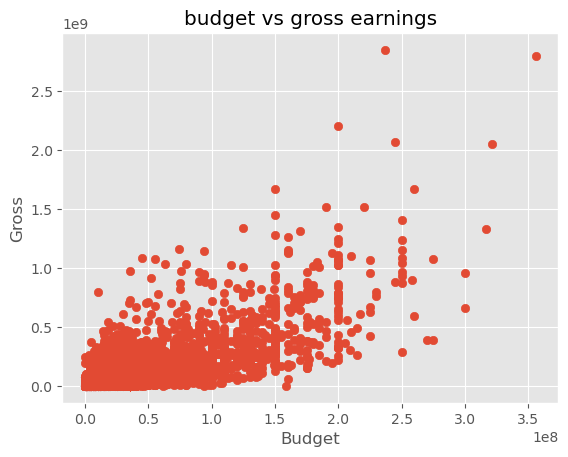

In [45]:
#using matplotlib
plt.scatter(x=df["budget"],y=df["gross"])
plt.title("budget vs gross earnings")
plt.xlabel("Budget")
plt.ylabel("Gross")
plt.show()

Text(0.5, 1.0, 'budget vs gross earnings')

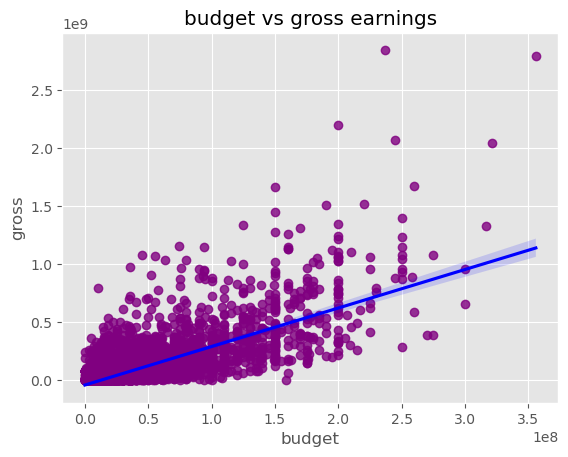

In [52]:
#using seaborn
sns.regplot(x="budget",y="gross",data=df,scatter_kws={"color":"purple"},line_kws={"color":"blue"})
plt.title("budget vs gross earnings")

In [59]:
df.corr(method="pearson") #pearson,kendall,spearman

C:\Users\Samhith\AppData\Local\Temp\ipykernel_15684\1928345917.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr(method="pearson") #pearson,kendall,spearman


,year,score,votes,budget,gross,runtime
year,1.000000,0.098084,0.222945,0.265578,0.252042,0.120811
score,0.098084,1.000000,0.409182,0.064455,0.182866,0.399412
votes,0.222945,0.409182,1.000000,0.421090,0.628713,0.309212
budget,0.265578,0.064455,0.421090,1.000000,0.711270,0.265305
gross,0.252042,0.182866,0.628713,0.711270,1.000000,0.241336
runtime,0.120811,0.399412,0.309212,0.265305,0.241336,1.000000


C:\Users\Samhith\AppData\Local\Temp\ipykernel_15684\3201470755.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix=df.corr(method="pearson")


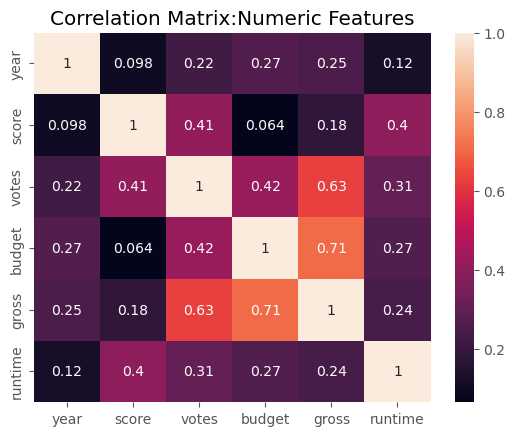

In [66]:
correlation_matrix=df.corr(method="pearson")
sns.heatmap(correlation_matrix,annot=True)
plt.title("Correlation Matrix:Numeric Features")
plt.show()

In [67]:
#votes and budget have a comparatively high correlation with gross within the numeric features

In [68]:
#converting non-numeric fields to numeric

In [73]:
df_numerized=df

for column in df_numerized.columns:
    if(df_numerized[column].dtype=="object"):
        df_numerized[column]=df_numerized[column].astype('category')
        df_numerized[column]=df_numerized[column].cat.codes
df_numerized

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,6587,6,6,1980,1705,8.4,927000.0,2589,4014,1047,54,19000000,46998772,2319,146.0
1,5573,6,1,1980,1492,5.8,65000.0,2269,1632,327,55,4500000,58853106,731,104.0
2,5142,4,0,1980,1771,8.7,1200000.0,1111,2567,1745,55,18000000,538375067,1540,124.0
3,286,4,4,1980,1492,7.7,221000.0,1301,2000,2246,55,3500000,83453539,1812,88.0
4,1027,6,4,1980,1543,7.3,108000.0,1054,521,410,55,6000000,39846344,1777,98.0
5,2109,6,10,1980,2502,6.4,123000.0,2528,4362,241,55,550000,39754601,1812,95.0
6,5574,6,0,1980,1771,7.9,188000.0,1412,838,1277,55,27000000,115229890,2281,133.0
7,4436,6,3,1980,699,8.2,330000.0,1829,1769,2240,55,18000000,23402427,631,129.0
8,5281,4,0,1980,1753,6.8,101000.0,2306,1979,877,55,54000000,108185706,883,127.0
9,6213,6,3,1980,2286,7.0,10000.0,2864,423,589,55,10000000,15795189,2272,100.0


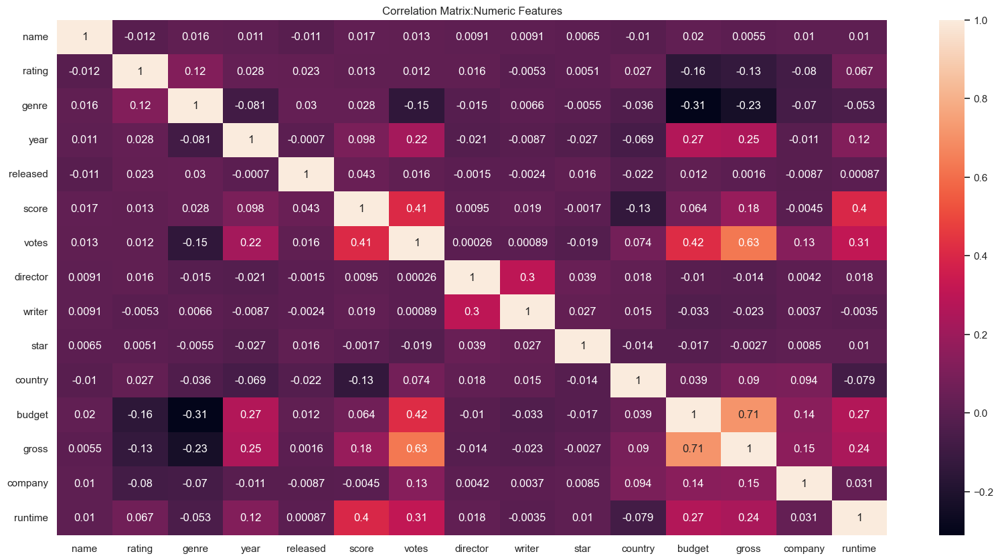

In [90]:
correlation_matrix=df_numerized.corr(method="pearson")
sns.heatmap(correlation_matrix,annot=True)
sns.set(rc={"figure.figsize":(40,10)})
plt.title("Correlation Matrix:Numeric Features")
plt.show()

In [92]:
corr_pairs=correlation_matrix.unstack()
corr_pairs

name      name        1.000000
          rating     -0.012441
          genre       0.016355
          year        0.011453
          released   -0.011311
          score       0.017114
          votes       0.013088
          director    0.009079
          writer      0.009081
          star        0.006472
          country    -0.010425
          budget      0.020368
          gross       0.005466
          company     0.010369
          runtime     0.010392
rating    name       -0.012441
          rating      1.000000
          genre       0.123465
          year        0.027931
          released    0.023466
          score       0.013304
          votes       0.012379
          director    0.016255
          writer     -0.005289
          star        0.005092
          country     0.026930
          budget     -0.156544
          gross      -0.130083
          company    -0.079626
          runtime     0.066647
genre     name        0.016355
          rating      0.123465
        

In [93]:
sorted_pairs=corr_pairs.sort_values()
sorted_pairs

genre     budget     -0.310566
budget    genre      -0.310566
genre     gross      -0.230267
gross     genre      -0.230267
rating    budget     -0.156544
budget    rating     -0.156544
votes     genre      -0.145307
genre     votes      -0.145307
score     country    -0.134538
country   score      -0.134538
gross     rating     -0.130083
rating    gross      -0.130083
year      genre      -0.081261
genre     year       -0.081261
company   rating     -0.079626
rating    company    -0.079626
runtime   country    -0.079269
country   runtime    -0.079269
company   genre      -0.070013
genre     company    -0.070013
year      country    -0.069423
country   year       -0.069423
runtime   genre      -0.052711
genre     runtime    -0.052711
          country    -0.035896
country   genre      -0.035896
budget    writer     -0.033216
writer    budget     -0.033216
star      year       -0.027242
year      star       -0.027242
writer    gross      -0.023210
gross     writer     -0.023210
released

In [99]:
high_corr=sorted_pairs[(sorted_pairs)>0.5]
high_corr

gross     votes       0.628713
votes     gross       0.628713
gross     budget      0.711270
budget    gross       0.711270
name      name        1.000000
director  director    1.000000
gross     gross       1.000000
budget    budget      1.000000
country   country     1.000000
star      star        1.000000
writer    writer      1.000000
votes     votes       1.000000
score     score       1.000000
released  released    1.000000
year      year        1.000000
genre     genre       1.000000
rating    rating      1.000000
company   company     1.000000
runtime   runtime     1.000000
dtype: float64

### no non-numeric field has a high correlation with gross
### neither a company nor a country influence the gross revenue generated by a movie